# import

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
plt.rcParams['figure.figsize'] = (10,10)
plt.rcParams['figure.dpi'] = 500
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor
from sklearn import tree
from sklearn.preprocessing import OrdinalEncoder
from sklearn.metrics import classification_report , confusion_matrix
sns.set_style('darkgrid')
plt.rcParams['figure.figsize'] = (10,5)

# Data

In [2]:
df = pd.read_csv('./Company_Data.csv')
df


,Sales,CompPrice,Income,Advertising,Population,Price,ShelveLoc,Age,Education,Urban,US
0,9.50,138,73,11,276,120,Bad,42,17,Yes,Yes
1,11.22,111,48,16,260,83,Good,65,10,Yes,Yes
2,10.06,113,35,10,269,80,Medium,59,12,Yes,Yes
3,7.40,117,100,4,466,97,Medium,55,14,Yes,Yes
4,4.15,141,64,3,340,128,Bad,38,13,Yes,No
...,...,...,...,...,...,...,...,...,...,...,...
395,12.57,138,108,17,203,128,Good,33,14,Yes,Yes
396,6.14,139,23,3,37,120,Medium,55,11,No,Yes
397,7.41,162,26,12,368,159,Medium,40,18,Yes,Yes
398,5.94,100,79,7,284,95,Bad,50,12,Yes,Yes


In [3]:
sns.pairplot(df,hue='ShelveLoc')

# Data processing

In [4]:
df=pd.get_dummies(df,columns=['ShelveLoc','Urban','US'], drop_first=True)

In [5]:
df

,Sales,CompPrice,Income,Advertising,Population,Price,Age,Education,ShelveLoc_Good,ShelveLoc_Medium,Urban_Yes,US_Yes
0,9.50,138,73,11,276,120,42,17,False,False,True,True
1,11.22,111,48,16,260,83,65,10,True,False,True,True
2,10.06,113,35,10,269,80,59,12,False,True,True,True
3,7.40,117,100,4,466,97,55,14,False,True,True,True
4,4.15,141,64,3,340,128,38,13,False,False,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...
395,12.57,138,108,17,203,128,33,14,True,False,True,True
396,6.14,139,23,3,37,120,55,11,False,True,False,True
397,7.41,162,26,12,368,159,40,18,False,True,True,True
398,5.94,100,79,7,284,95,50,12,False,False,True,True


# Visualization

<Axes: xlabel='Age', ylabel='Sales'>

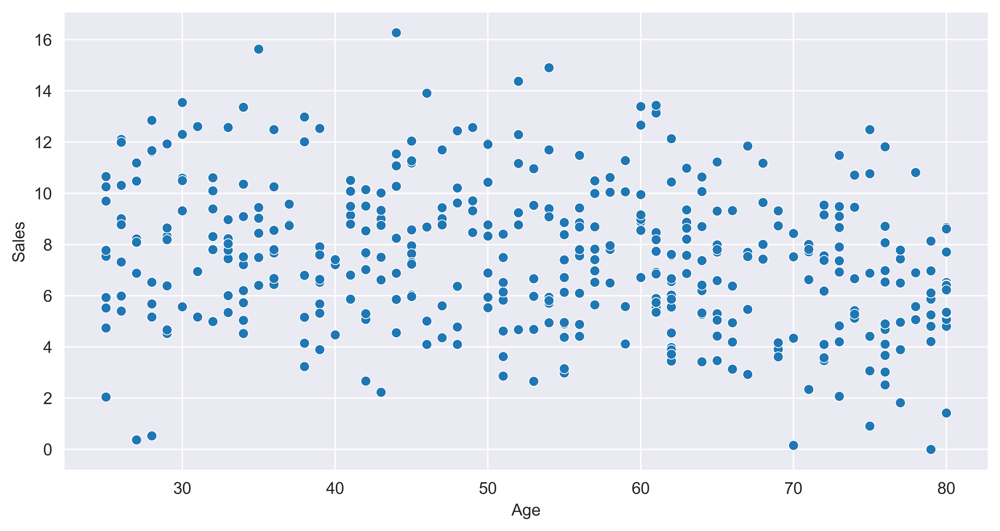

In [6]:
sns.scatterplot(x=df['Age'],y=df['Sales'])

<Axes: xlabel='CompPrice', ylabel='Sales'>

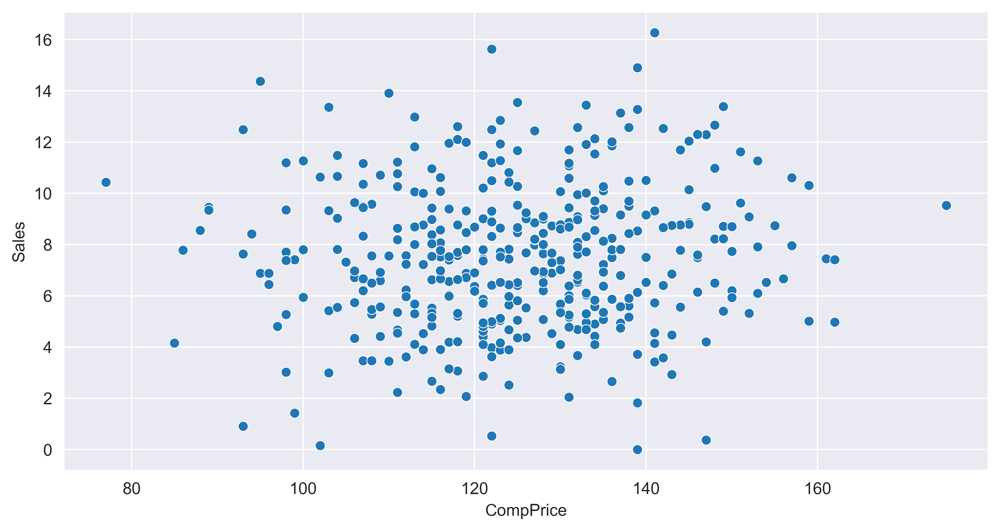

In [7]:
sns.scatterplot(x=df['CompPrice'],y=df['Sales'])

<Axes: xlabel='Population', ylabel='Sales'>

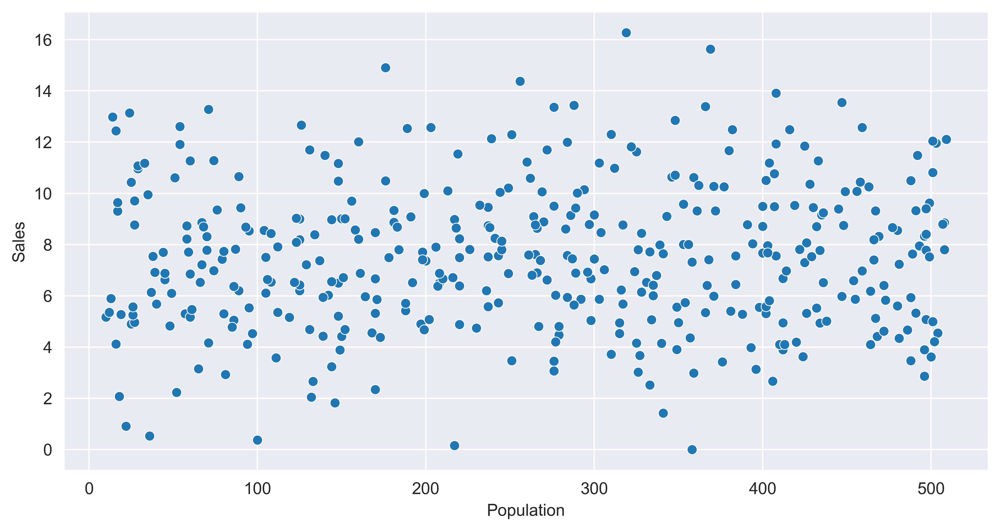

In [8]:
sns.scatterplot(x=df['Population'],y=df['Sales'])

<Axes: xlabel='Urban_Yes', ylabel='count'>

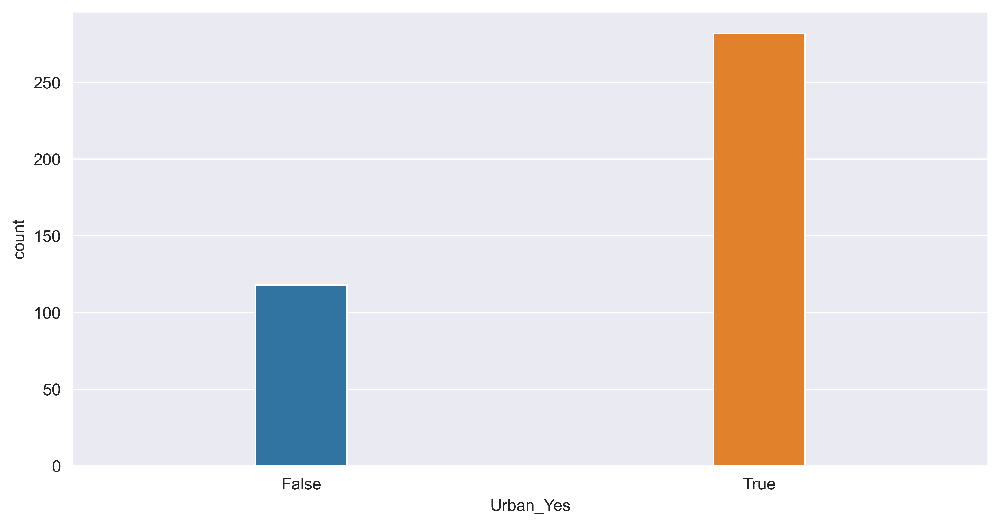

In [9]:
sns.countplot(data=df,x='Urban_Yes',width=0.2)

<Axes: xlabel='US_Yes', ylabel='count'>

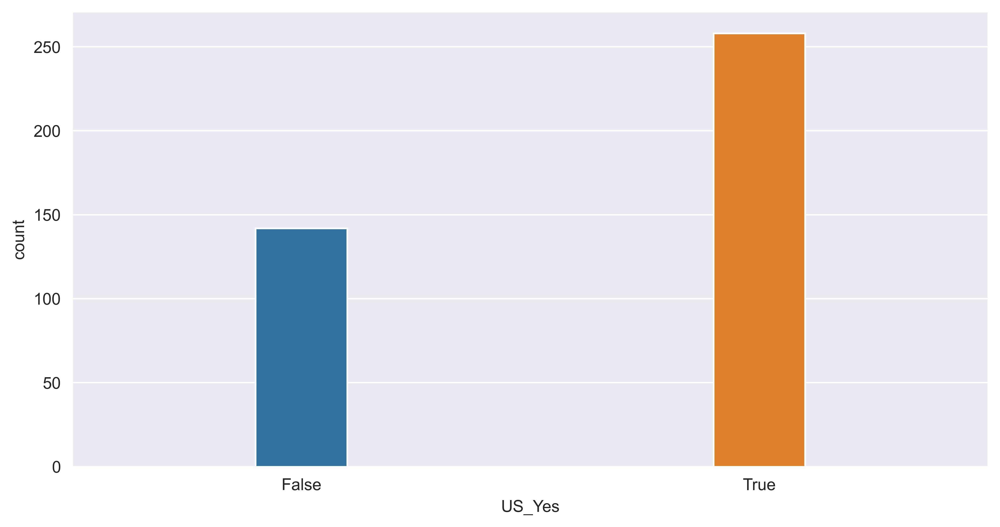

In [10]:
sns.countplot(data=df,x='US_Yes',width=0.2)

# Decision Tree

In [11]:
# split the feature and target
X = df.drop('Sales',axis=1)
Y = df['Sales']

In [12]:
# split train test 
xtrain,xtest,ytrain,ytest = train_test_split(X,Y,test_size=0.1,random_state=42)

In [13]:
dt_c5r = DecisionTreeRegressor().fit(xtrain,ytrain)

In [14]:
print('Training accuracy: ', dt_c5r.score(xtrain,ytrain))
print('Testing Accuracy: ', dt_c5r.score(xtest,ytest))

Training accuracy:  1.0
Testing Accuracy:  0.6633785909636553


[Text(0.6003528570614168, 0.96875, 'ShelveLoc_Good <= 0.5\nsquared_error = 7.607\nsamples = 360\nvalue = 7.464'),
 Text(0.3139620230313165, 0.90625, 'Price <= 105.5\nsquared_error = 5.859\nsamples = 286\nvalue = 6.796'),
 Text(0.12857251444207965, 0.84375, 'Age <= 49.5\nsquared_error = 5.198\nsamples = 100\nvalue = 8.188'),
 Text(0.04743083003952569, 0.78125, 'Income <= 57.5\nsquared_error = 3.527\nsamples = 37\nvalue = 9.513'),
 Text(0.024931590148981452, 0.71875, 'Advertising <= 9.0\nsquared_error = 1.412\nsamples = 11\nvalue = 7.978'),
 Text(0.018242626938279112, 0.65625, 'Price <= 100.5\nsquared_error = 0.845\nsamples = 8\nvalue = 7.455'),
 Text(0.012161751292186074, 0.59375, 'ShelveLoc_Medium <= 0.5\nsquared_error = 0.455\nsamples = 6\nvalue = 7.857'),
 Text(0.007297050775311645, 0.53125, 'US_Yes <= 0.5\nsquared_error = 0.141\nsamples = 3\nvalue = 7.387'),
 Text(0.00486470051687443, 0.46875, 'Age <= 38.0\nsquared_error = 0.02\nsamples = 2\nvalue = 7.64'),
 Text(0.00243235025843721

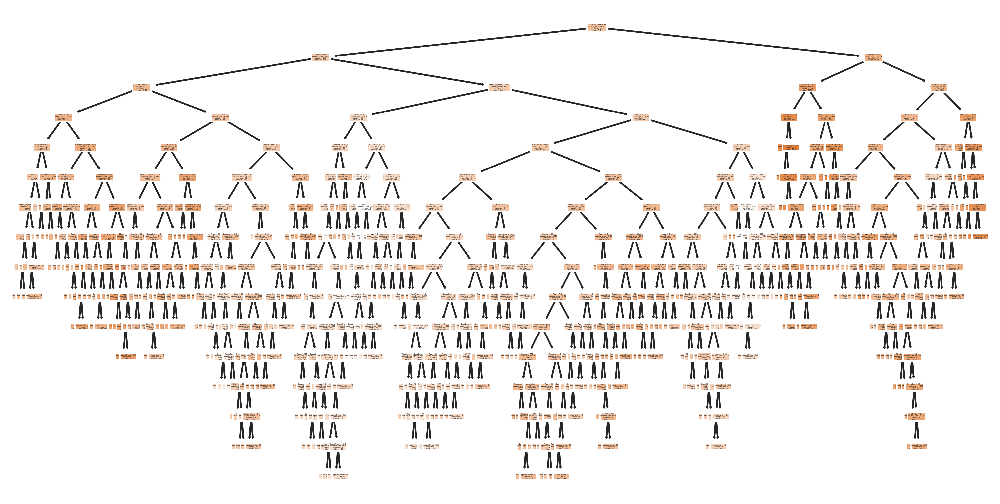

In [15]:
tree.plot_tree(dt_c5r,feature_names=X.columns,filled=True)

# Hyper Parameter Tuning

In [16]:
from sklearn.model_selection import GridSearchCV

In [17]:
params = {
    'criterion' : ['squared_error', 'absolute_error','friedman_mse'],
    'max_depth' : [None,17,15,20],
    'splitter' : ['best','random'],
    'max_features' : ['sqrt', 'log2'],
    'ccp_alpha' : [0,0.01,0.1,1]
}
grid = GridSearchCV(DecisionTreeRegressor(),params,verbose=1).fit(xtrain,ytrain)

Fitting 5 folds for each of 192 candidates, totalling 960 fits


In [18]:
grid.best_score_ , grid.best_params_ 

(0.39146413577184036,
 {'ccp_alpha': 0.1,
  'criterion': 'friedman_mse',
  'max_depth': None,
  'max_features': 'log2',
  'splitter': 'best'})

In [19]:
grid.best_estimator_.score(xtest,ytest)

0.3017157424031198

*The Default tree gives the best performance*

# Feature Importance

In [20]:
dt_c5r.feature_importances_

array([0.10885438, 0.08530937, 0.07954868, 0.03130847, 0.25500352,
       0.11041689, 0.02711215, 0.22640757, 0.06795914, 0.00583145,
       0.00224837])

In [21]:
feature_df = pd.DataFrame({'Feature':X.columns,
                          'Importance':dt_c5r.feature_importances_})
feature_df.sort_values('Importance',ascending=False,inplace=True)

In [22]:
feature_df

,Feature,Importance
4,Price,0.255004
7,ShelveLoc_Good,0.226408
5,Age,0.110417
0,CompPrice,0.108854
1,Income,0.085309
2,Advertising,0.079549
8,ShelveLoc_Medium,0.067959
3,Population,0.031308
6,Education,0.027112
9,Urban_Yes,0.005831


<Axes: xlabel='Importance', ylabel='Feature'>

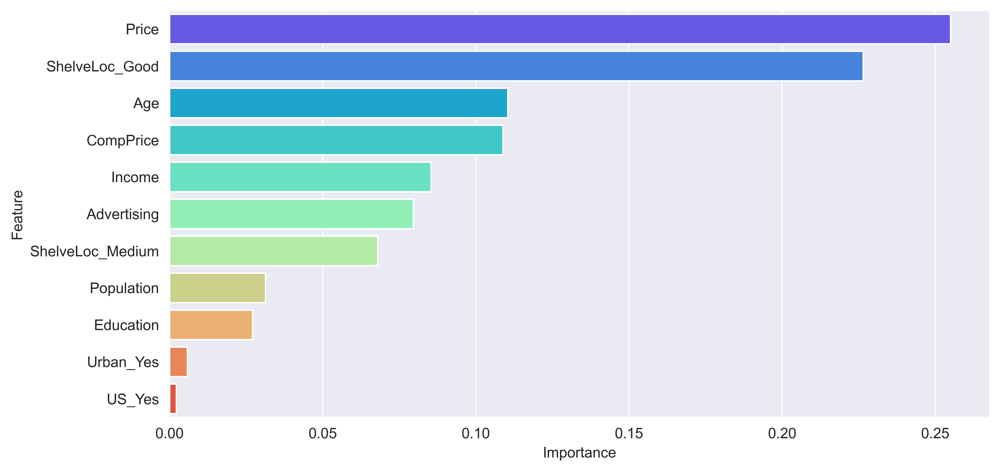

In [23]:
sns.barplot(data=feature_df,y='Feature',x='Importance',palette='rainbow')

**Observation:**<br>
* *Price has the highest importance.*
* *Top 3 features that affect sales are Price , ShelveLoc_Good and Age*